A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Pl

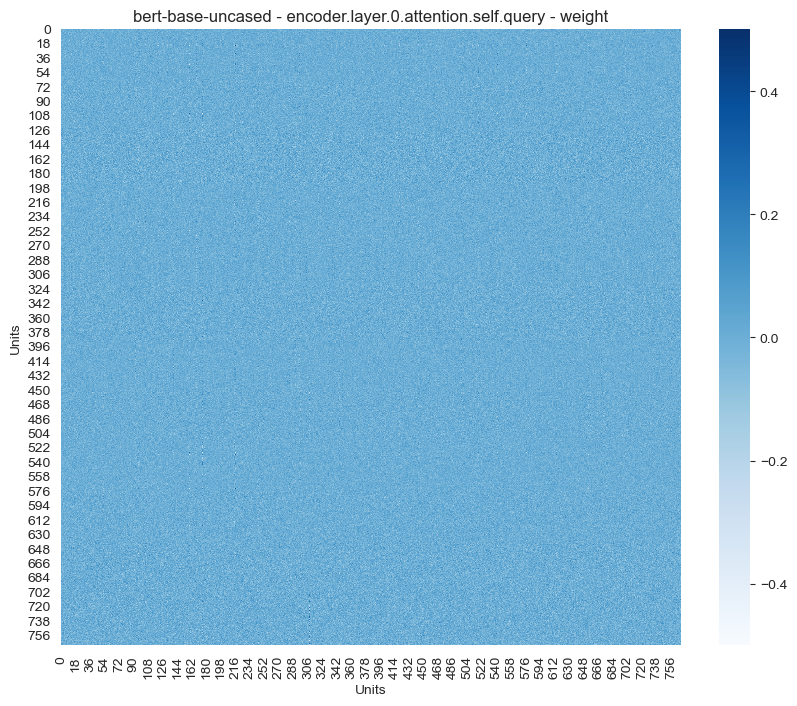

In [15]:
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from transformers import AutoModel, AutoTokenizer

def visualize_model_parameters(model_name, layer_name, parameter_type='weight', vmin=None, vmax=None):
    """
    可视化 Hugging Face 模型的特定层参数（白色到深蓝色渐变）。
    
    参数:
        model_name (str): Hugging Face 模型名称。
        layer_name (str): 模型中层的名称（如 'bert.encoder.layer.0.attention.self.query'）。
        parameter_type (str): 要可视化的参数类型（'weight' 或 'bias'）。
        vmin (float): 颜色映射的最小值。默认 None，即自动确定。
        vmax (float): 颜色映射的最大值。默认 None，即自动确定。
    """
    # 加载模型
    model = AutoModel.from_pretrained(model_name)
    model.eval()  # 设置模型为评估模式
    
    # 获取特定层
    layer = dict(model.named_modules()).get(layer_name)
    if layer is None:
        raise ValueError(f"Layer {layer_name} not found in model {model_name}.")
    
    # 获取参数
    param = dict(layer.named_parameters()).get(parameter_type)
    if param is None:
        raise ValueError(f"Parameter {parameter_type} not found in layer {layer_name}.")
    
    # 转为 numpy 数组
    param_data = param.detach().cpu().numpy()
    
    # 创建白色到深蓝色的渐变
    cmap = plt.get_cmap('Blues')
    
    # 可视化
    plt.figure(figsize=(10, 8))
    sns.heatmap(param_data, cmap=cmap, vmin=vmin, vmax=vmax, cbar=True)
    plt.title(f"{model_name} - {layer_name} - {parameter_type}")
    plt.xlabel("Units")
    plt.ylabel("Units")
    plt.show()

if __name__ == "__main__":
    # 示例用法
    model_name = "bert-base-uncased"
    layer_name = "encoder.layer.0.attention.self.query"  # 选择模型的某一层
    parameter_type = "weight"  # 可选 "weight" 或 "bias"
    
    # 设置参数范围
    vmin = -0.5  # 最小值
    vmax = 0.5  # 最大值
    
    visualize_model_parameters(model_name, layer_name, parameter_type, vmin=vmin, vmax=vmax)


In [25]:
import torch
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from transformers import AutoModel

def visualize_model_parameters_interactive(model_name, layer_name, parameter_type='weight'):
    """
    交互式可视化 Hugging Face 模型的特定层参数。
    
    参数:
        model_name (str): Hugging Face 模型名称。
        layer_name (str): 模型中层的名称（如 'bert.encoder.layer.0.attention.self.query'）。
        parameter_type (str): 要可视化的参数类型（'weight' 或 'bias'）。
    """
    # 加载模型
    model = AutoModel.from_pretrained(model_name)
    model.eval()  # 设置模型为评估模式
    
    # 获取特定层
    layer = dict(model.named_modules()).get(layer_name)
    if layer is None:
        raise ValueError(f"Layer {layer_name} not found in model {model_name}.")
    
    # 获取参数
    param = dict(layer.named_parameters()).get(parameter_type)
    if param is None:
        raise ValueError(f"Parameter {parameter_type} not found in layer {layer_name}.")
    
    # 转为 numpy 数组
    param_data = param.detach().cpu().numpy()

    # 创建热力图
    fig = go.Figure(data=go.Heatmap(
        z=param_data,
        colorscale='RdBu',  # 使用白色到深蓝色的渐变
        colorbar=dict(title="Parameter Value")
    ))

    # 设置标题和标签
    fig.update_layout(
        title=f"{model_name} - {layer_name} - {parameter_type}",
        xaxis_title="Units",
        yaxis_title="Units",
        xaxis=dict(scaleanchor="y"),  # 保持横纵比例一致
        yaxis=dict(scaleanchor="x"),
    )

    # 显示图像
    fig.show()

if __name__ == "__main__":
    # 示例用法
    model_name = "bert-base-uncased"
    layer_name = "encoder.layer.0.attention.self.query"  # 选择模型的某一层
    parameter_type = "weight"  # 可选 "weight" 或 "bias"
    
    visualize_model_parameters_interactive(model_name, layer_name, parameter_type)


A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Pl